# Master rad - Prepoznavanje i praćenje vozila u realnom vremenu
## Esmir Pljakić 2021/3074 

In [1]:
# Ucitavanje potrebnih biblioteka, neophodnih, za dalji rad

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
%matplotlib inline

import pandas as pd
import numpy as np
import random
import glob
import time
import cv2
import os

import skimage
from skimage import *
from skimage.feature import hog
from sklearn.svm import LinearSVC
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

import moviepy
from moviepy.editor import VideoFileClip
from scipy.ndimage.measurements import label

*Učitavanje i prikaz slika, na kojima se nalaze i ne nalaze vozila, iz kojih će biti izvučena HOG obeležja i koje će se koristiti za obučavanje SVM klasifikatora. U ovom delu će biti učitane i test slike izvučene iz videa na kome će algoritam biti testiran.*

In [2]:
# Ucitavanje test slika iz videa
test_img = glob.glob('slike/test/*.jpg')

# Ucitavanje slika na kojima se nalaze i ne nalaze vozila
car_img = []
non_car_img = []

for root, dirs, files in os.walk('./slike/vehicles/'):
    for file in files:
        if file.endswith('.png'):
            car_img.append(os.path.join(root, file))
            
for root, dirs, files in os.walk('./slike/non-vehicles/'):
    for file in files:
        if file.endswith('.png'):
            non_car_img.append(os.path.join(root, file))
    
# Broj ucitanih slika na kojima se nalaze i ne nalaze vozila i dimenzije ucitanih slika
N_car = len(car_img)
N_non_car = len(non_car_img)
img_shape = mpimg.imread(car_img[0]).shape

print('Broj slika na kojima se nalaze vozila : {: > 7}'. format(N_car))
print('Broj slika na kojima se ne nalaze vozila : {}'. format(N_non_car))
print('Dimenzije ucitanih slika : {}'. format(img_shape))

Broj slika na kojima se nalaze vozila :    8792
Broj slika na kojima se ne nalaze vozila : 8968
Dimenzije ucitanih slika : (64, 64, 3)


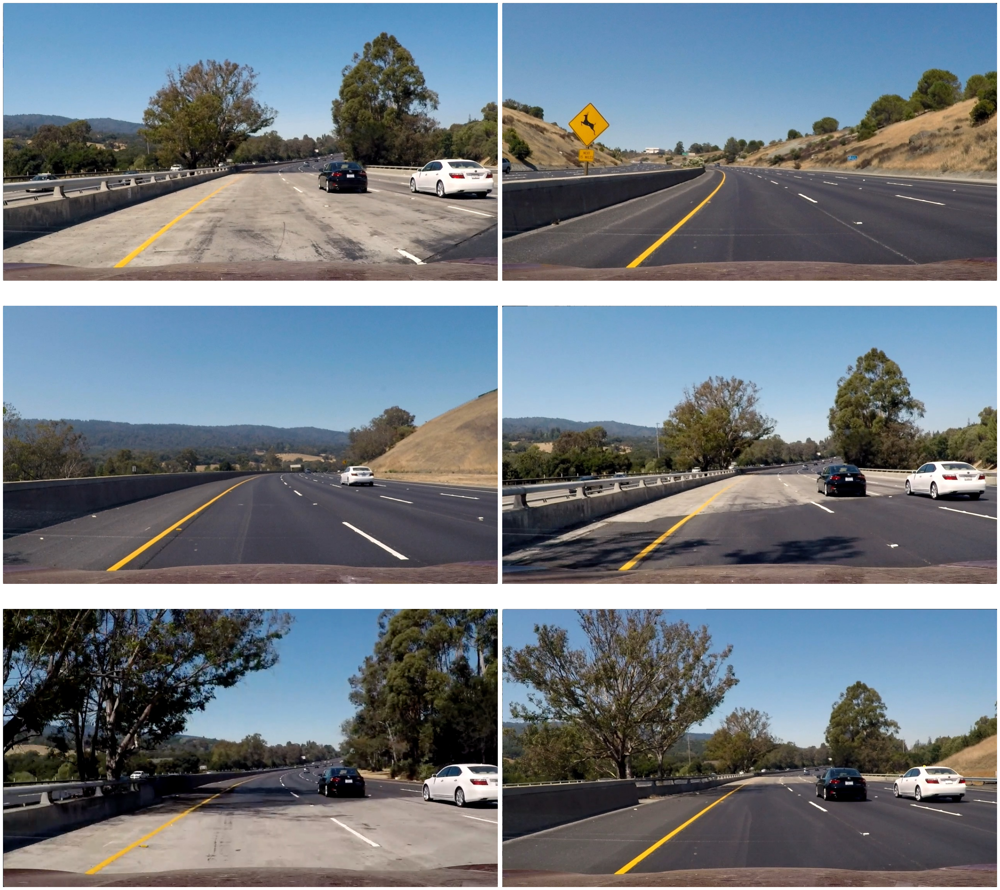

In [3]:
# Prikaz test slika
fig, axs = plt.subplots(3,2, figsize=(34,32), dpi=80)
fig.subplots_adjust(hspace = .0, wspace = .1)
axs = axs.ravel()

for i in np.arange(6):
    img = cv2.imread(test_img[i])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    axs[i].axis('off')
    axs[i].imshow(img)

fig.tight_layout()

# Cuvanje slike
plt.savefig('slike_izlaz/test_img.png')

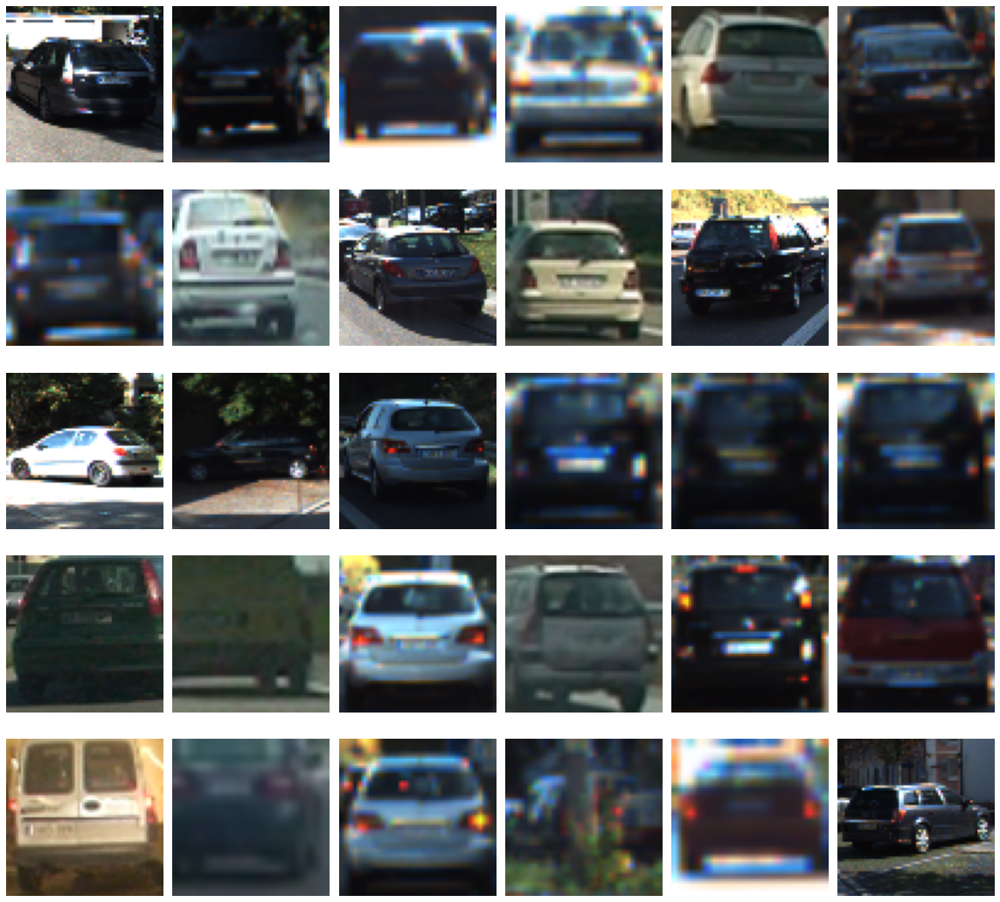

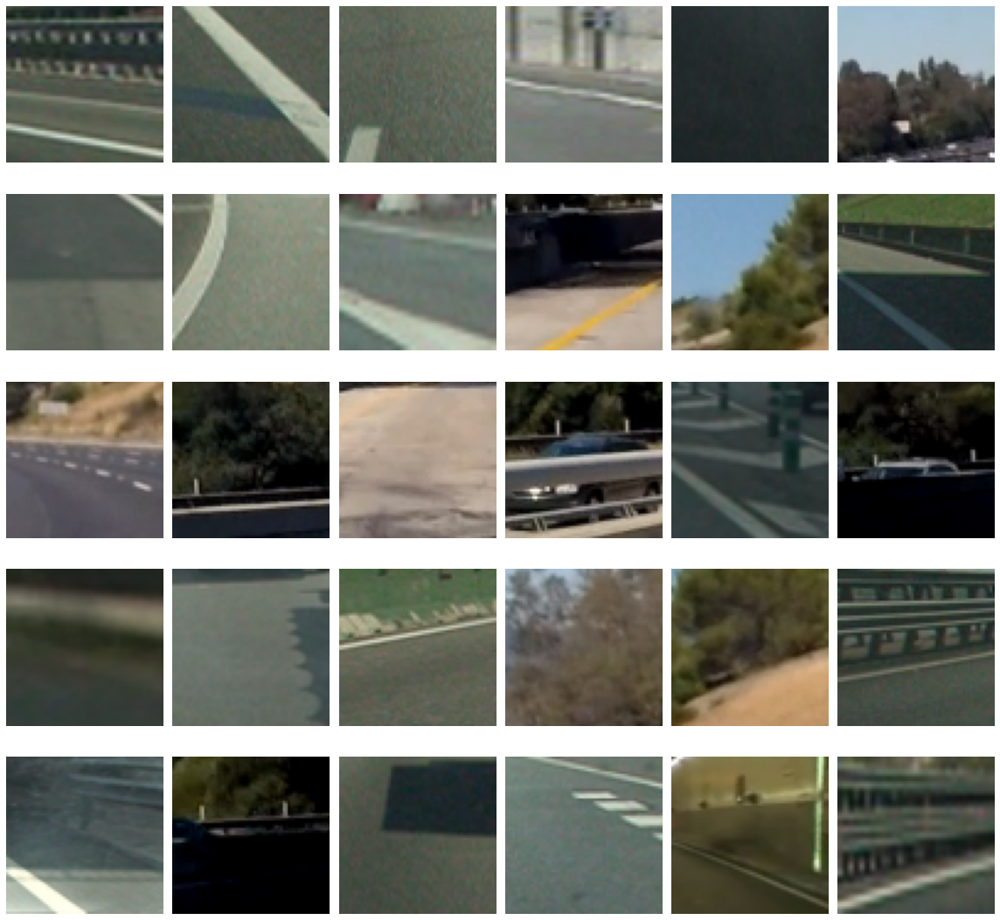

In [9]:
# Prikaz odredjenog broja slika na kojima se nalaze vozila
fig, axs = plt.subplots(5,6, figsize=(16, 16))
fig.subplots_adjust(hspace = -.3, wspace = .1)
axs = axs.ravel()

for i in np.arange(30):
    img = cv2.imread(car_img[np.random.randint(0,N_car)])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    axs[i].axis('off')
    axs[i].imshow(img)

fig.tight_layout()
    
# Cuvanje slike
plt.savefig('slike_izlaz/car_img.png')

# Prikaz odredjenog broja slika na kojima se ne nalaze vozila
fig, axs = plt.subplots(5,6, figsize=(16, 16))
fig.subplots_adjust(hspace = -.3, wspace = -.1)
axs = axs.ravel()

for i in np.arange(30):
    img = cv2.imread(non_car_img[np.random.randint(0,N_non_car)])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    axs[i].axis('off')
    axs[i].imshow(img)

fig.tight_layout()
    
# Cuvanje slike
plt.savefig('slike_izlaz/non_car_img.png')

In [5]:
"""""
    Funkcija koja ima zadatak da vrati HOG obeležja ulazne slike i da vrati odgovarajuću sliku HOG obeležja.
    input:
        img             : ulazna slika
        orientation     : orijentacija - broj binova u histogramu
        pixel_per_cell  : broj piksela unutar jedne celije
        cells_per_block : broj celija unutar svakog bloka
        block_norm      : normalizacija na nivou bloka (L2-Hys - histerezna L2 norma, max. vrednost 0.2)
        transform_sqrt  : predprocesiranje - kompresija slike (ne raditi ako slika ima neg. vrednosti)
        visualize       : true/false - da li hocemo sliku HOG-a ili ne
        feature_vector  : vektor obeležja
    output:
        fetures         : dobijena obeležja
        hog_img         : slika HOG-a
        
"""""
def hog_features(img, orientation, pixel_per_cell, cell_per_block, vis=False, feature_vec=True):
    # Ukoliko je vizuelizacija ukljucena imacemo 2 izlaza: obelezja i sliku HOG-a
    if vis == True:
        features, hog_image = hog(img, orientations=orientation, 
                                  pixels_per_cell=(pixel_per_cell, pixel_per_cell),
                                  cells_per_block=(cell_per_block, cell_per_block),
                                  transform_sqrt=True,
                                  block_norm= 'L2',
                                  visualize=vis, 
                                  feature_vector=feature_vec)
        return features, hog_image
    # U suprotnom imacemo samo obelezja
    else:      
        features = hog(img, orientations=orientation, 
                       pixels_per_cell=(pixel_per_cell, pixel_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block),
                       transform_sqrt=True, 
                       block_norm= 'L2',
                       feature_vector=feature_vec)
        return features

*Vizuelni prikaz HOG slika dobijenih iz prethodne funkcije.*

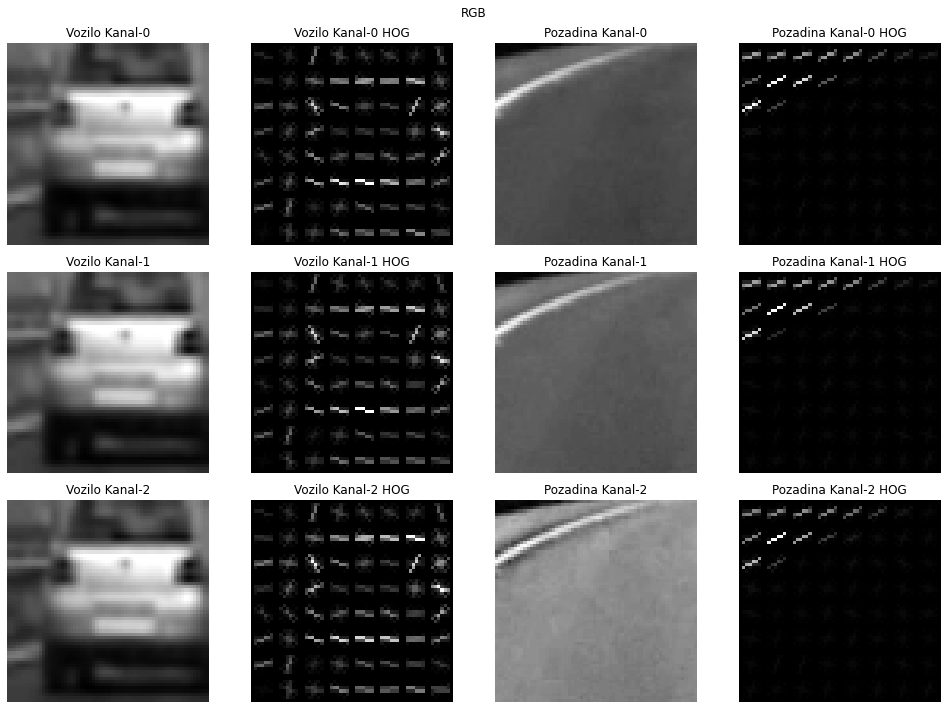

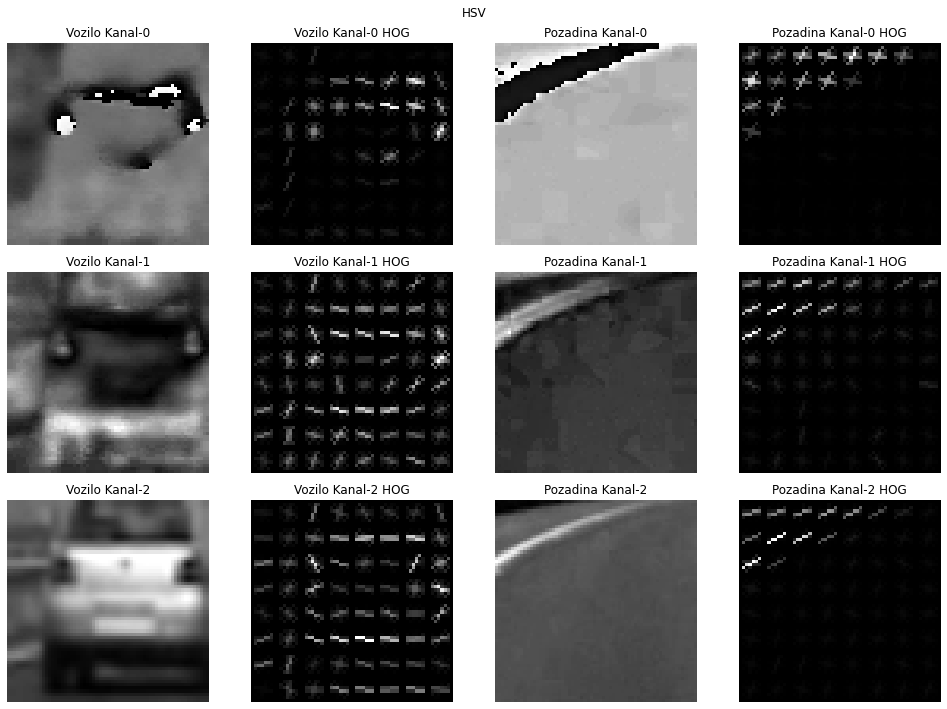

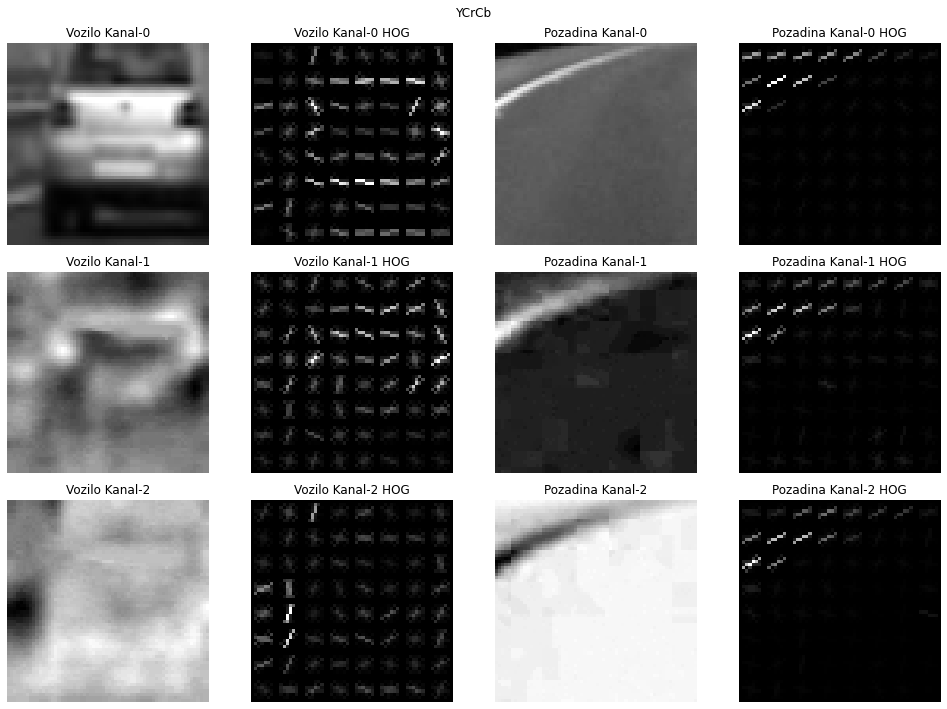

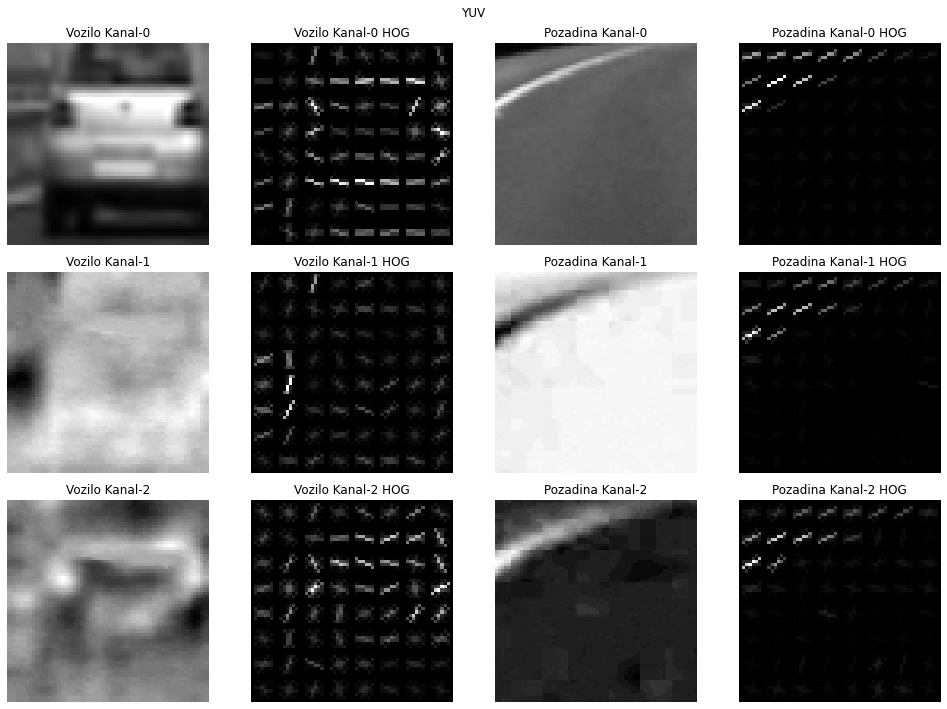

In [6]:
# Dohvatanje dve slike: 1-vozilo, 2-bez vozila
car_img_test = mpimg.imread(car_img[100])
non_car_img_test = mpimg.imread(non_car_img[100])

# Prikaz HOG obelezja u tri razlicita prostora boja
color_spaces = ('RGB', 'HSV', 'YCrCb', 'YUV')

for c_space in color_spaces:
    car_test = car_img_test
    non_car_test = non_car_img_test
    
    # Transformacija u drugi prostor boja
    if(c_space == 'HSV'):
        car_test = cv2.cvtColor(car_img_test, cv2.COLOR_RGB2HSV)
        non_car_test = cv2.cvtColor(non_car_img_test, cv2.COLOR_RGB2HSV)
    elif (c_space == 'YCrCb'):
        car_test = cv2.cvtColor(car_img_test, cv2.COLOR_RGB2YCrCb)
        non_car_test = cv2.cvtColor(non_car_img_test, cv2.COLOR_RGB2YCrCb)
    elif (c_space == 'YUV'):
        car_test = cv2.cvtColor(car_img_test, cv2.COLOR_RGB2YUV)
        non_car_test = cv2.cvtColor(non_car_img_test, cv2.COLOR_RGB2YUV)
    
    # Cuvanje dobijenih HOG slika i adekvatnih naslova
    images = []
    titles = []

    # Prolazak kroz sva tri kanala slika (nebitno koji je prostor boja) 
    for i in range(3):
        for image, img_type in zip([car_test, non_car_test], ['Vozilo', 'Pozadina']):
            channel = image[:,:,i]
            images.append(channel)
            titles.append(img_type + ' Kanal-%d' % i)
            features, hog_image = hog_features(channel, orientation=12, pixel_per_cell=8, cell_per_block=2, vis=True, feature_vec=False)
            images.append(hog_image)
            titles.append(img_type + ' Kanal-%d' % i + ' HOG')
    
    # Iscrtavanje
    fig, axes = plt.subplots(3, 4, figsize=(14, 10))
    fig.subplots_adjust(hspace = .2, wspace = .1)
    fig.suptitle(c_space)
    axes = axes.ravel()
    for ax, img, title in zip(axes, images, titles):
        ax.imshow(img, cmap='gray')
        ax.set_title(title)
        ax.axis('off')
        
    fig.tight_layout()
    plt.savefig('slike_izlaz/hog_slike_' + c_space + '.png')

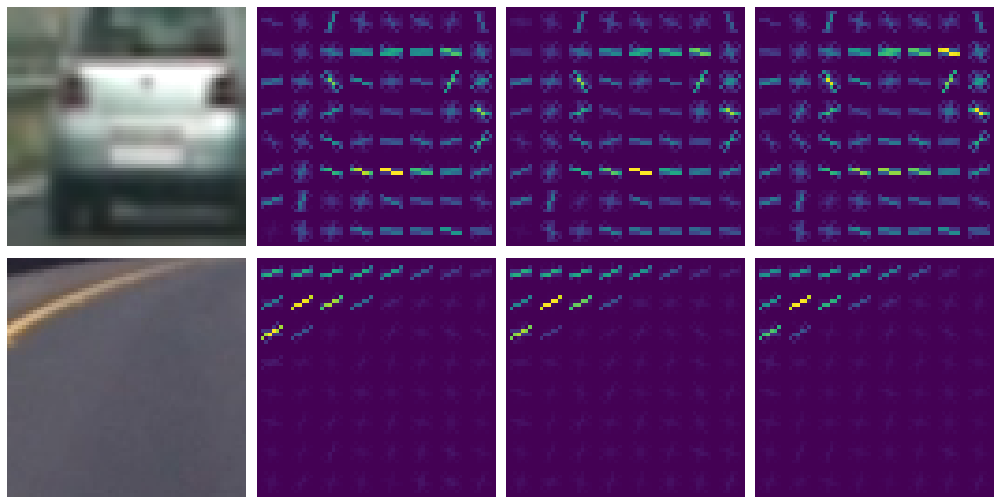

In [7]:
# Cuvanje dobijenih HOG slika i adekvatnih naslova
images = []
titles = []

# Prolazak kroz sva tri kanala slika (nebitno koji je prostor boja) 
for image in (car_img_test, non_car_img_test):
    images.append(image)
    car_test = cv2.cvtColor(car_img_test, cv2.COLOR_RGB2YUV)
    non_car_test = cv2.cvtColor(non_car_img_test, cv2.COLOR_RGB2YUV)
    for i in range(3):
        channel = image[:,:,i]
        features, hog_image = hog_features(channel, orientation=12, pixel_per_cell=8, cell_per_block=2, vis=True, feature_vec=False)
        images.append(hog_image)
    
fig, axes = plt.subplots(2, 4, figsize=(14, 10))
fig.subplots_adjust(hspace = -.6, wspace = .1)
axes = axes.ravel()
for ax, img in zip(axes, images):
    ax.imshow(img)
    ax.axis('off')
        
fig.tight_layout()
plt.savefig('slike_izlaz/hog_obelezja.png')

*Izdvajanje HOG obelеžja iz trenirajućih slika uz pomoć prethodne funkcije i funkcija koje će biti definisane u nastavku.*

In [8]:
"""""
    Funkcija koja ima zadatak da izdvoji obeležja, ulazne slike, koja se odnose na vrednosti piksela.
    input:
        img     : ulazna slika
        size    : nova veličina slike iz koje će se izvući obeležja
    output:
        fetures : dobijeni vektor obeležja    
"""""
def pixel_features(img, size=(32, 32)):
    features = cv2.resize(img, size).ravel() 
    return features


"""""
    Funkcija koja ima zadatak da izdvoji obeležja, ulazne slike, koja se odnose na vrednosti histograma piksela.
    input:
        img        : ulazna slika
        nbins      : broj binova na koje će histogram biti podeljen
        bins_range : opseg vrednosti binova (pikseli od 0-255)
    output:
        fetures    : dobijeni vektor obeležja    
"""""
def histogram_features(img, nbins=32, bins_range=(0, 256)):
    c1_hist = np.histogram(img[:,:,0], bins=nbins, range=bins_range)
    c2_hist = np.histogram(img[:,:,1], bins=nbins, range=bins_range)
    c3_hist = np.histogram(img[:,:,2], bins=nbins, range=bins_range)
    features = np.concatenate((c1_hist[0], c2_hist[0], c3_hist[0]))
    return features


"""""
    Funkcija koja ima zadatak da izdvoji sve pomenuta obeležja i da ih ujedini.
    input:
        images           : ulazne slike
        color_space      : željeni prostor boja
        channel          : sa kog kanala će se izdvajati HOG obeležja
    output:
        fetures    : dobijeni vektor obeležja    
"""""
def extract_features(images, color_space='RGB', orientation=9, pixel_per_cell=8, cell_per_block=2, channel=0, 
                     p_size=(32, 32), nbins=32, bins_range=(0, 256)): 
    # Lista u kojoj ce se cuvati izdvojena obelezja
    features = []
    
    # Prolazak kroz sve ulazne slike
    for file in images:
        image = cv2.imread(file)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Obelezja za tekucu sliku
        current_features = []
        
        # Konverzija u zeljeni prostor boja  
        if color_space != 'RGB':
            if color_space == 'HSV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
            elif color_space == 'LUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
            elif color_space == 'HLS':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
            elif color_space == 'YUV':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
            elif color_space == 'YCrCb':
                feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
        else: feature_image = np.copy(image)   
        
        # Izdvajanje obelezja na osnovu vrednosti piksela
        features_pixel = pixel_features(feature_image, p_size)
        current_features.append(features_pixel)
        
        # Izdvajanje obelezja na osnovu histograma vrednosti piksela
        features_histogram = histogram_features(feature_image, nbins, bins_range)
        current_features.append(features_histogram)
        
        # Izdvajanje HOG obelezja
        # Moguce je odabrati da se HOG obelezja izdvajaju sa posebnog kanala
        if channel == 'ALL':
            features_hog = []
            for ch in range(feature_image.shape[2]):
                features_hog.append(hog_features(feature_image[:,:,ch], orientation, pixel_per_cell, 
                                    cell_per_block, vis=False, feature_vec=True))
            features_hog = np.ravel(features_hog)        
        else:
            features_hog = hog_features(feature_image[:,:,channel], orientation, pixel_per_cell, 
                                        cell_per_block, vis=False, feature_vec=True)
        current_features.append(features_hog)
        
        # Konacni vektor obelezja
        features.append(np.concatenate(current_features))
        
    return features


*Izdvajanje HOG obelеžja za učitane slike na kojima se nalaze i ne nalaze vozila.*

In [9]:
# Parametri sa kojim ce funkcija 'extract_features' biti pozvana
color_space = 'YUV' # 'RGB' 'HSV' 'HLS'
orientation = 9
pixel_per_cell = 8 
cell_per_block = 2
channel = 'ALL' # 0, 1, 2
p_size = (32, 32)
nbins = 32

car_features = extract_features(car_img, color_space, orientation, pixel_per_cell, cell_per_block, channel, p_size, nbins) 
non_car_features = extract_features(non_car_img, color_space, orientation, pixel_per_cell, cell_per_block, channel, p_size, nbins)

print('Broj izdvojenih obelezja : {}'. format(len(car_features[0])))

Broj izdvojenih obelezja : 8460


*Formiranje testirajućeg i trenirajućeg skupa od izdvojenih obeležja za testiranja SVM klasifikatora.*

In [10]:
# Ulazni vektor obelezja sa slika na kojima se nalaze vozila i na kojima se ne nalaze
X_input = np.vstack((car_features, non_car_features)).astype(np.float64)

# Izlazni vektor 1-vozilo 2-bez vozila
Y_output = np.hstack((np.ones(len(car_features)), np.zeros(len(non_car_features))))

# Podela podataka na trenirajuci (80%) i testirajuci (20%) skup pomocu 'train_test_split' funkcije
rnd = np.random.randint(0, 100)
X_train, X_test, Y_train, Y_test = train_test_split(X_input, Y_output, test_size=0.2, random_state=rnd)

# Skaliranje ulaznog vektora obelezja tako da raspodela obelezja bude priblizna normalnoj raspodeli
scaler = StandardScaler().fit(X_input)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

*SVM(Support Vector Machine) klasifikator.*

In [11]:
# Koristicu linearni SVC kao klasifikator
linear_svc = LinearSVC()

# Obucavanje klasifikatora
linear_svc.fit(X_train, Y_train)
print('Uspesnost klasifikatora na test skupu : {}%'. format(round(100*linear_svc.score(X_test, Y_test), 4)))

Uspesnost klasifikatora na test skupu : 99.268%


In [12]:
from sklearn.metrics import confusion_matrix
Y_pred = linear_svc.predict(X_test)
confusion_matrix(Y_test, Y_pred)

array([[1783,    8],
       [  18, 1743]], dtype=int64)

In [13]:
print(np.shape(X_train))
print(np.shape(X_test))

(14208, 8460)
(3552, 8460)


In [14]:
# Testiranje klasifikatora - prikaz uspesnosti klasifikacije na nekoliko test slika
param = linear_svc.predict(X_test[20:30])
print(param)
print(Y_test[20:30])

[0. 1. 1. 1. 0. 1. 1. 1. 1. 0.]
[0. 1. 1. 1. 0. 1. 1. 1. 1. 0.]


In [15]:
"""""
    Funkcija koja ima zadatak da detektuje sva vozila na ulaznoj slici u datom regionu za razlicite velicine (skale) prozora.
    input:
        image            : ulazna slika
        ystart           : y0 - tacka regiona od interesa
        ystop            : y1 - tacka regiona od interesa
        xstart           : x0 - tacka regiona od interesa
        xstop            : y1 - tacka regiona od interesa
        scale            : velicina sa kojom se region od interesa skalira
        linear_svc       : klasifikator
        scaler           : skaliranje vektora obelezja
        vis              : parametar kojim se ukljucuje vizuelizacija - prikaz svih prozora na kojima se trazi vozilo
    output:
        vehicle_window   : pozicije prozora na kojima je vozilo detektovano
        vis_window       : pozicije svih prozora na kojima se vrsila pretraga da li vozilo postoji ili ne
        
"""""
def find_vehicles(image, ystart, ystop, xstart=0, xstop=1280, scale=1, linear_svc=linear_svc, scaler=scaler, 
                  orientation=9, pixel_per_cell=8, cell_per_block=2, size=(32, 32), nbins=32, channel='ALL', vis=False):
       
    # Isecak slike koji ce se analizirati, tj. region od interesa (ROI)
    img_cropp = image[ystart:ystop, xstart:xstop, :]
    
    # Promena prostora boja iz RGB-a u YCrCb
    img_crop = cv2.cvtColor(img_cropp, cv2.COLOR_RGB2YUV)
    
    # Skaliranje ROI-a
    if scale != 1:
        img_shape = img_crop.shape
        img_crop = cv2.resize(img_crop, (np.int(img_shape[1]/scale), np.int(img_shape[0]/scale)))
        
    # Dohvatanje svakog kanala ponaosob
    ch1 = img_crop[:,:,0]
    ch2 = img_crop[:,:,1]
    ch3 = img_crop[:,:,2]
    
    # Odredjivanje broja blokova i broja koraka koje je potrebno napraviti prilikom trazenja vozila na ROI regionu
    x_blocks = (ch1.shape[1] // pixel_per_cell) - cell_per_block + 1
    y_blocks = (ch1.shape[0] // pixel_per_cell) - cell_per_block + 1
    window = 64
    w_blocks = (window // pixel_per_cell) - cell_per_block + 1
    cells_per_step = 2
    x_steps  = (x_blocks - w_blocks) // cells_per_step
    y_steps  = (y_blocks - w_blocks) // cells_per_step
    
    # HOG obelezja za svaki kanal
    hog_c1 = hog_features(ch1, orientation, pixel_per_cell, cell_per_block, feature_vec=False)
    hog_c2 = hog_features(ch2, orientation, pixel_per_cell, cell_per_block, feature_vec=False)
    hog_c3 = hog_features(ch3, orientation, pixel_per_cell, cell_per_block, feature_vec=False)
    
    # Lista u kojoj ce se cuvati prozori na kojima je vozilo detektovano
    vehicle_window = []
    
    # Lista u kojoj ce se cuvati pozicije svih prozora u kojima ce vozilo biti pretrazeno
    vis_window = []
    
    for x_step in range(x_steps):
        for y_step in range(y_steps):
            x = x_step*cells_per_step
            y = y_step*cells_per_step
            
            # Izdvajanje HOG obelezja za dati region
            hog_1 = hog_c1[y:y + w_blocks, x:x + w_blocks].ravel() 
            hog_2 = hog_c2[y:y + w_blocks, x:x + w_blocks].ravel()
            hog_3 = hog_c3[y:y + w_blocks, x:x + w_blocks].ravel()
            features_hog1 = np.hstack((hog_1, hog_2, hog_3))
            
            # Pomeranje prozora
            x_left = x*pixel_per_cell
            y_top = y*pixel_per_cell
            image_win = cv2.resize(img_crop[y_top:y_top + window, x_left:x_left + window], (64,64))
            
            """""
            # Izdvajanje HOG obelezja na drugi nacin
            features_hog = []
            for ch in range(image_win.shape[2]):
                features_hog.append(hog_features(image_win[:,:,ch], orientation, pixel_per_cell, 
                                    cell_per_block, vis=False, feature_vec=False))
            features_hog = np.ravel(features_hog) 
            """""
            
            # Izdvajanje obelezja na osnovu vrednosti piksela
            features_pixel = pixel_features(img=image_win, size=size)
        
            # Izdvajanje obelezja na osnovu histograma vrednosti piksela
            features_histogram = histogram_features(img=image_win, nbins=nbins)
            
            # Skaliranje obelezja 
            features = scaler.transform(np.hstack((features_pixel, features_histogram, features_hog1)).reshape(1, -1))
            
            # Prepoznavanje vozila
            vehicle_prediction = linear_svc.predict(features)
            
            if vehicle_prediction == 1:
                x_draw_left = xstart + np.int(x_left*scale)
                y_draw_top = ystart + np.int(y_top*scale)
                window_draw = np.int(window*scale)
                win = ((x_draw_left, y_draw_top), (x_draw_left+window_draw, y_draw_top+window_draw))
                vehicle_window.append(win)
                
            # Cuvanje svih regiona u zavisnosti od skaliranje i od selektovanog regiona od interesa
            if vis == True:
                x_draw_left = np.int(x_left*scale)
                y_draw_top = ystart + np.int(y_top*scale)
                window_draw = np.int(window*scale)
                box = ((x_draw_left, y_draw_top),(x_draw_left+window_draw, y_draw_top+window_draw))
                vis_window.append(box)
                
    return vehicle_window, vis_window

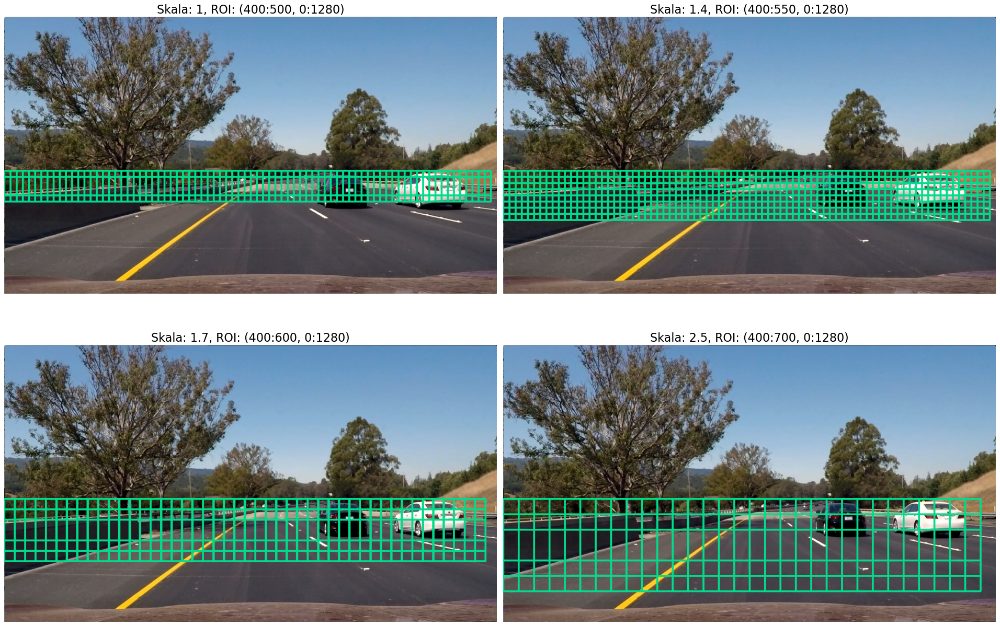

In [16]:
"""""
    Funkcija koja ima zadatak da iscrta listu prozora na ulaznoj slici.
    input:
        image         : ulazna slika
        windows       : lista prozora
        color         : boja
        thickness     : debljina icrtavanja prozora na slici
    output:
        image_draw    : ulazna slika na kojoj su iscrtani prozori  
"""""
def draw_windows(image, windows, color = (0,220,140), thickness = 3):
    image_draw = np.copy(image)
    for win in windows:
        # Funkcija koja iscrtava pravougaonike na slici
        cv2.rectangle(img = image_draw, pt1 = win[0], pt2 = win[1], color = color, thickness = thickness)
    return image_draw

# Iscrtavanje prozora za razlicite skale i razlicite regione od interesa na nekoj od test slika
test_image = cv2.imread(test_img[5])
test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)

# Pozivanje funkcije koja pronalazi vozila sa ukljucenom vizuelizacijom svih prozora
_, vis_window1 = find_vehicles(test_image, 400, 500, 0, 1280, 1 , vis = True)
_, vis_window2 = find_vehicles(test_image, 400, 550, 0, 1280, 1 , vis = True)
_, vis_window3 = find_vehicles(test_image, 400, 600, 0, 1280, 1.7 , vis = True)
_, vis_window4 = find_vehicles(test_image, 400, 700, 0, 1280, 2.5 , vis = True)

# Pozivanje funkcije za iscrtavanje prozora koji su pronadjeni uz pomoc funkcije 'find_vehicles'
test_image_box1 = draw_windows(test_image, vis_window1)
test_image_box2 = draw_windows(test_image, vis_window2)
test_image_box3 = draw_windows(test_image, vis_window3)
test_image_box4 = draw_windows(test_image, vis_window4)

# Iscrtavanje izlaznih slika
fig, axs = plt.subplots(2,2, figsize=(24,20), dpi=80)
fig.subplots_adjust(hspace = -.4, wspace = .1)
axs = axs.ravel()
axs[0].axis('off')
axs[0].imshow(test_image_box1)
axs[0].set_title('Skala: 1, ROI: (400:500, 0:1280)', fontsize=20)
axs[1].axis('off')
axs[1].imshow(test_image_box2)
axs[1].set_title('Skala: 1.4, ROI: (400:550, 0:1280)', fontsize=20)
axs[2].axis('off')
axs[2].imshow(test_image_box3)
axs[2].set_title('Skala: 1.7, ROI: (400:600, 0:1280)', fontsize=20)
axs[3].axis('off')
axs[3].imshow(test_image_box4)
axs[3].set_title('Skala: 2.5, ROI: (400:700, 0:1280)', fontsize=20)

# Cuvanje slike
plt.savefig('slike_izlaz/prozori.png')
fig.tight_layout()

In [17]:
"""""
    Funkcija koja ima zadatak da iscrta jedan prozor oko jednog vozila pomocu labela.
    input:
        image         : ulazna slika
        labels        : lista pozicija prozora koja je objedinjuje sve bliske prozore na kojima je vozilo detektovano
        color         : boja
        thickness     : debljina icrtavanja prozora na slici
    output:
        image_draw    : ulazna slika na kojoj je icrtan po jedan prozor oko jednog vozila
"""""
def draw_vehicle(image, labels, color = (0,220,140), thickness = 3 ):
    # Prolazak kroz detektovana vozila
    for car_number in range(1, labels[1]+1):
        nonzero = (labels[0] == car_number).nonzero()
        x = np.array(nonzero[1])
        y = np.array(nonzero[0])
        win = ((np.min(x), np.min(y)), (np.max(x), np.max(y)))
        
        # Crtanje prozora oko detektovanog vozila
        cv2.rectangle(img = image, pt1 = win[0],  pt2 = win[1], color = color, thickness = thickness)
    return image

In [18]:
"""""
    Funkcija koja ima zadatak da detektuje vozila za razlicite velicine prozora i da objedini pronadjene prozore.
    input:
        image             : ulazna slika
        vis               : parametar kojim se ukljucuje vizuelizacija
    output:
        final_image       : ulazna slika koja sadrzi jedan prozor oko jednog vozila
        svm_detection     : ulazna slika koja sadrzi vise prozora oko jednog vozila
        window_matrix     : matrica koja je ispunjena nulama, osim na mestima gde se nalaze prozori oko vozila
        window_matrix_thr : window_matrix matrica na kojoj je primenjen odgovarajuci prag
"""""
def draw_detected_vehicles(image, vis = False):
    # Matrica ispunjena nulama, istih dimenzija kao ulazna slika
    window_matrix = np.zeros(shape=(720, 1280)).astype(np.int8)
    
    # Lista u kojoj ce se cuvati prozori razlicitih dimenzija na kojima su detektovana vozila
    windows = []
    
    # Pozicije piksela uzete kao poceci regiona od interesa
    ystart = [400, 400, 400, 450]
    ystop = [500, 550, 600, 700]
    xstart = 0
    xstop = 1280
    
    # Skaliranje sa vrednoscu 1
    win1, _ = find_vehicles(image, ystart[0], ystop[0], xstart, xstop, scale=1)
    windows.extend(win1)
    
    # Skaliranje sa vrednoscu 1.4
    win2, _ = find_vehicles(image, ystart[1], ystop[1], xstart, xstop, scale=1.4)
    windows.extend(win2)
    
    # Skaliranje sa vrednoscu 1.7
    win3, _ = find_vehicles(image, ystart[2], ystop[2], xstart, xstop, scale=1.7)
    windows.extend(win3)
    
    # Skaliranje sa vrednoscu 2.5
    win4, _ = find_vehicles(image, ystart[3], ystop[3], xstart, xstop, scale=2.5)
    windows.extend(win4)
    
    # Prikaz svih prozora na kojima je vozilo detektovano
    svm_detection = np.copy(image)
    for win in windows:
        cv2.rectangle(img = svm_detection, pt1 = win[0], pt2 = win[1], color = (0,220,140), thickness = 3)
    
    # Prolazenje kroz sva detekotvana vozila i uvecavanje onih elemenata matrice na kojima je vozilo detektovano
    for win in windows:
        # windows sadrzi ovakav oblik (x1,y1),(x2,y2)
        window_matrix[win[0][1]:win[1][1], win[0][0]:win[1][0]] += 1 
    
    # Detektovana vozila iz suprotne trake su uklonjena pomocu jednostavnog poredjenja sa pragom
    window_matrix_thr = np.copy(window_matrix)
    window_matrix_thr[window_matrix <= 1] = 0
    
    # Funkcija koja grupise sve elemente matrice koji pripadaju delu slike gde se nalazi vozilo
    labels = label(window_matrix_thr)
    
    # Iscrtavanje pronadjenih vozila
    final_image = draw_vehicle(np.copy(image), labels)
    
    if vis == True:
        return final_image, svm_detection, window_matrix, window_matrix_thr
    else:
        return final_image

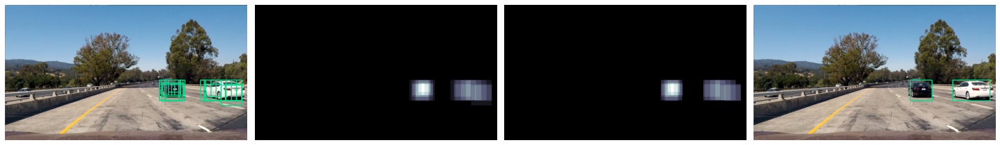

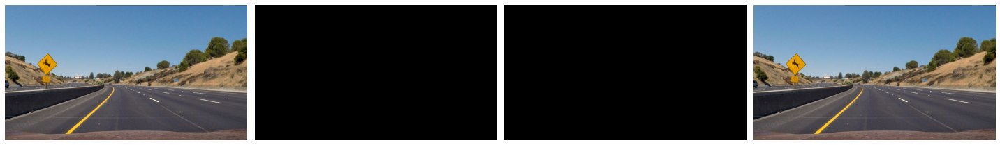

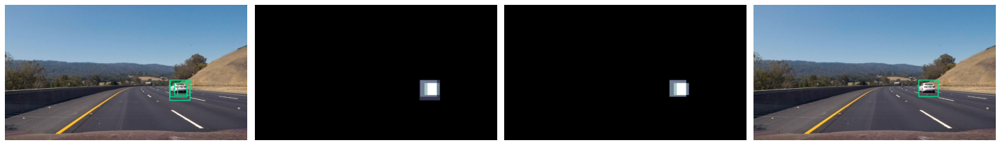

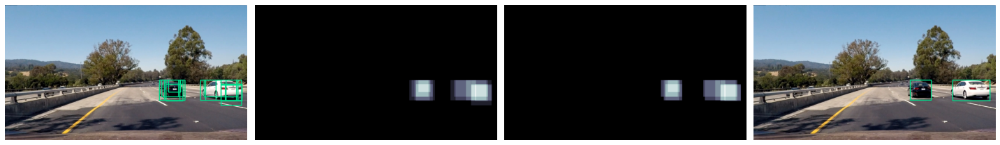

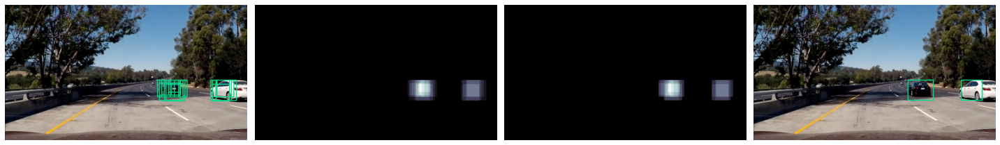

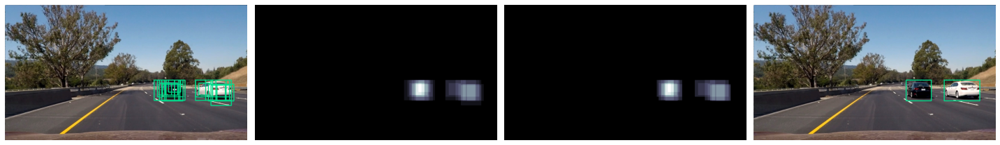

In [19]:
test_img = glob.glob('slike/test/*.jpg')
test_image = []
for name in test_img:
    img = cv2.cvtColor(cv2.imread(name), cv2.COLOR_BGR2RGB)
    test_image.append(img)

# Prolazak kroz sve test slike i pozivanje funkcije za nalazenje vozila
for i, test_img in enumerate(test_image):
    final_image, detection, win, win_threshold = draw_detected_vehicles(test_img, vis = True)
    
    # Iscrtavanje
    f, ax = plt.subplots(1, 4, figsize=(20,5))
    ax[0].imshow(detection)
    ax[0].axis('off')
    ax[1].imshow(win, cmap = 'bone')
    ax[1].axis('off')
    ax[2].imshow(win_threshold, cmap = 'bone')
    ax[2].axis('off')
    ax[3].imshow(final_image)
    ax[3].axis('off')
    f.tight_layout()
    
    # Cuvanje slike
    # plt.savefig('slike_izlaz/test_slika_detekcija_' + str(i) + '.png')

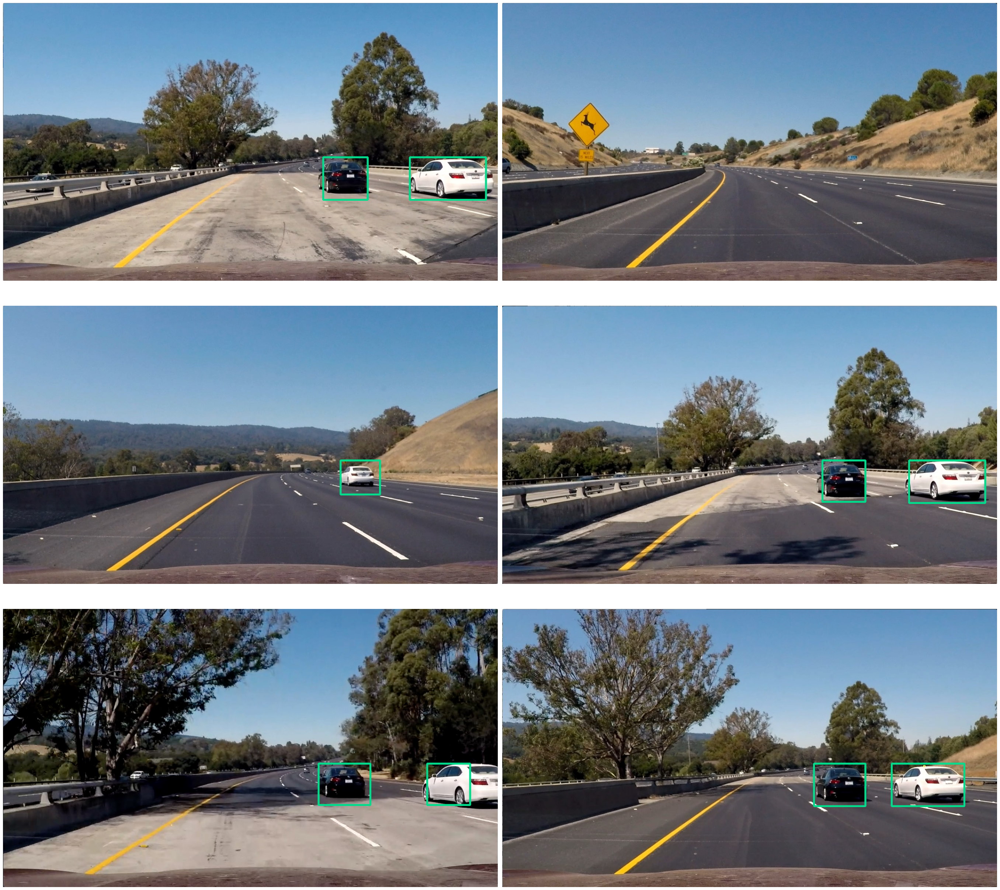

In [21]:
test_img = glob.glob('slike/test/*.jpg')
test_image = []
for name in test_img:
    img = cv2.cvtColor(cv2.imread(name), cv2.COLOR_BGR2RGB)
    test_image.append(img)

# Rezultat algoritma primenjenog na testirajuce slike
result_image = []
    
# Prolazak kroz sve test slike i pozivanje funkcije za nalazenje vozila
for test_img in test_image:
    final_image = draw_detected_vehicles(test_img)
    result_image.append(final_image)
    
# Iscrtavanje rezultata
fig, axs = plt.subplots(3,2, figsize=(34,32), dpi=80)
fig.subplots_adjust(hspace = .0, wspace = .1)
axs = axs.ravel()

for i in range(6):
    axs[i].axis('off')
    axs[i].imshow(result_image[i])

fig.tight_layout()

# Cuvanje slike
plt.savefig('slike_izlaz/result_test_img.png')

*Testiranje algoritma za detekciju i pracenje vozila u realnom vremenu na snimku.*

In [26]:
# Ucitavenje test snimka i testiranje algoritma za detekciju vozila na tom snimku
output_video = 'output_video.mp4'
input_video  = VideoFileClip('input_video.mp4')

# Testiranje algoritma i cuvanje snimka sa rezultatima detekcije vozila
video = input_video.fl_image(draw_detected_vehicles)
video.write_videofile(output_video, audio=False)

Moviepy - Building video output_video.mp4.
Moviepy - Writing video output_video.mp4



Moviepy - Done !
Moviepy - video ready output_video.mp4
